<a href="https://colab.research.google.com/github/Piternicolas/Classifying-Fetal-Health/blob/main/Classifying_Fetal_Health_with_Auto_ML.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Fetal Health**
Let's talk a little about this subject, going to science size, the Machine Learning Algorithms are an efficient tool for various professional areas and in Health area it wouldn't be different. With the tecnology we have at the moment is possible predict if someone will have some health problem, in this project I'll focus on a Fetal Health, I have a dataset with fetus data and I need to make a algorithm that is able to classify with a good precision the fetus that may have a health problem.
* **`Dataset:`**
 * https://www.kaggle.com/datasets/andrewmvd/fetal-health-classification
<p align="center"><img src="https://img.freepik.com/vetores-gratis/ilustracao-de-feto-desenhado-a-mao_23-2149205952.jpg?w=740&t=st=1689961546~exp=1689962146~hmac=a0302a077c464881e47c752814a8327a40a81b81b4c20bf501e0631c53e1e3c1" width="50%"></p>

To help me and facilitate my work I'll use a smart, fast and efficient approach, the Auto Machine Learning. And to make it using **PyCaret**.

In [4]:
# Import the libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
!pip install pandas-profiling -q
from pandas_profiling import ProfileReport

In [27]:
# Setting the DF visualization
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [6]:
# Importing DF and viewing firsts rows
df = pd.read_csv('fetal_health.csv')
print('Cols: {}'.format(df.shape[1]))
print('Rows: {}'.format(df.shape[0]))
df[:5]

Cols: 22
Rows: 2126


,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,mean_value_of_long_term_variability,histogram_width,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.000,0.0,0.000,0.000,0.0,0.0,73.0,0.5,43.0,2.4,64.0,62.0,126.0,2.0,0.0,120.0,137.0,121.0,73.0,1.0,2.0
1,132.0,0.006,0.0,0.006,0.003,0.0,0.0,17.0,2.1,0.0,10.4,130.0,68.0,198.0,6.0,1.0,141.0,136.0,140.0,12.0,0.0,1.0
2,133.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.1,0.0,13.4,130.0,68.0,198.0,5.0,1.0,141.0,135.0,138.0,13.0,0.0,1.0
3,134.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.4,0.0,23.0,117.0,53.0,170.0,11.0,0.0,137.0,134.0,137.0,13.0,1.0,1.0
4,132.0,0.007,0.0,0.008,0.000,0.0,0.0,16.0,2.4,0.0,19.9,117.0,53.0,170.0,9.0,0.0,137.0,136.0,138.0,11.0,1.0,1.0


* ### We can see the columns and realize it are baby exams.

In [8]:
# COLUMNS
df.columns.tolist()

['baseline value',
 'accelerations',
 'fetal_movement',
 'uterine_contractions',
 'light_decelerations',
 'severe_decelerations',
 'prolongued_decelerations',
 'abnormal_short_term_variability',
 'mean_value_of_short_term_variability',
 'percentage_of_time_with_abnormal_long_term_variability',
 'mean_value_of_long_term_variability',
 'histogram_width',
 'histogram_min',
 'histogram_max',
 'histogram_number_of_peaks',
 'histogram_number_of_zeroes',
 'histogram_mode',
 'histogram_mean',
 'histogram_median',
 'histogram_variance',
 'histogram_tendency',
 'fetal_health']

* The columns names already are self explanatory. And the column that classify the fetus is **fetal_health**.

In [9]:
# Checking if are missing values
df.isna().sum()

baseline value                                            0
accelerations                                             0
fetal_movement                                            0
uterine_contractions                                      0
light_decelerations                                       0
severe_decelerations                                      0
prolongued_decelerations                                  0
abnormal_short_term_variability                           0
mean_value_of_short_term_variability                      0
percentage_of_time_with_abnormal_long_term_variability    0
mean_value_of_long_term_variability                       0
histogram_width                                           0
histogram_min                                             0
histogram_max                                             0
histogram_number_of_peaks                                 0
histogram_number_of_zeroes                                0
histogram_mode                          

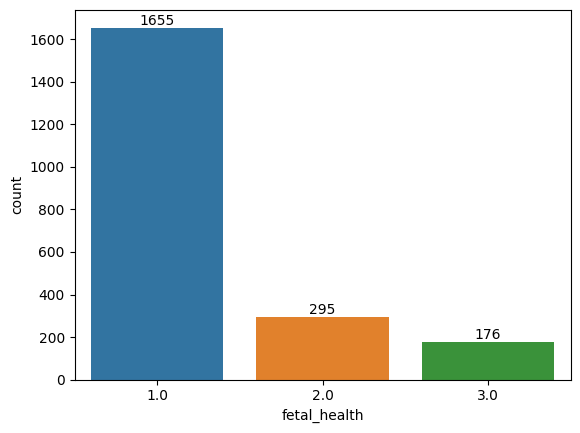

In [10]:
# Seeing the target column
for i, v in enumerate(df['fetal_health'].value_counts()):
  sns.countplot(x='fetal_health', data=df);
  plt.text(i,v, str(v), ha='center', va='bottom')

* Above is the target column, it shows 3 different classifications:
 * **`1.0:`** Normal.
 * **`2.0:`** Suspect.
 * **`3.0:`** Pathological.

And I'll give a higher attention to 2 and 3 classification.
---
# **DAR MAIS PREFERENCIA PARA O ALGORITMO FALSO POSITIVOS, MELHOR DIZER QUE VAI TER PROBLEMA PARA PODER TOMAR ATITUDES RAPIDAS DO QUE DIZER QUE NAO TEM E A CRIANÇA TER PROBLEMA**

Bellow is a general report that we can see all informations about the dataset.

In [11]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

* This report give us a lot of informations and it facilitate and saves our time, as the data is already ready, I'm going to program and started the classification.

In [12]:
# Import the necessary libraries
!pip install pycaret -q
import pycaret
from pycaret.classification import *

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 484.4/484.4 kB 4.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 153.4/153.4 kB 6.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.9/81.9 kB 7.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.5/212.5 kB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 9.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.8/106.8 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.4/73.4 kB 6.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 55.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.0/44.0 kB 3.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 50.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 53.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.4/10.4 MB 93.2 MB/s eta 0:0

In [13]:
# Spliting the data
test = df.sample(frac=0.1)
left = df.drop(test.index)

val = left.sample(frac=0.1)
train = left.drop(val.index)

test = test.reset_index(drop=True)
train = train.reset_index(drop=True)
val = val.reset_index(drop=True)

# Seeing how the data turned out
print('train:\t',train.shape)
print('test:\t',test.shape)
print('val:\t',val.shape)

train:	 (1722, 22)
test:	 (213, 22)
val:	 (191, 22)


* Now I'm going to set the setup params.

In [14]:
# Setup
model = setup(data=train, target='fetal_health',
              normalize=True,
              transformation=True,
              session_id=18,
              fix_imbalance=True)

,Description,Value
0,Session id,18
1,Target,fetal_health
2,Target type,Multiclass
3,Target mapping,"1.0: 0, 2.0: 1, 3.0: 2"
4,Original data shape,"(1722, 22)"
5,Transformed data shape,"(3334, 22)"
6,Transformed train set shape,"(2817, 22)"
7,Transformed test set shape,"(517, 22)"
8,Numeric features,21
9,Preprocess,True


In [15]:
# Comparing models
comp = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
xgboost,Extreme Gradient Boosting,0.9402,0.9816,0.9402,0.9416,0.9396,0.8367,0.8380,2.6180
lightgbm,Light Gradient Boosting Machine,0.9386,0.9839,0.9386,0.9400,0.9375,0.8305,0.8326,1.5130
gbc,Gradient Boosting Classifier,0.9385,0.9825,0.9385,0.9415,0.9390,0.8347,0.8363,3.9210
rf,Random Forest Classifier,0.9278,0.9809,0.9278,0.9305,0.9279,0.8055,0.8072,1.3220
et,Extra Trees Classifier,0.9236,0.9803,0.9236,0.9259,0.9234,0.7923,0.7933,0.8930
dt,Decision Tree Classifier,0.9112,0.8903,0.9112,0.9162,0.9121,0.7640,0.7657,1.0060
lr,Logistic Regression,0.8747,0.9611,0.8747,0.8980,0.8826,0.6927,0.7010,2.0110
knn,K Neighbors Classifier,0.8689,0.9444,0.8689,0.8934,0.8765,0.6789,0.6885,0.9290
ada,Ada Boost Classifier,0.8639,0.8936,0.8639,0.8809,0.8692,0.6464,0.6513,0.9910
svm,SVM - Linear Kernel,0.8622,0.0000,0.8622,0.8899,0.8712,0.6649,0.6750,0.3330


Processing:   0%|          | 0/65 [00:00<?, ?it/s]

In [16]:
# Printing the best model
print(comp)

XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=-1, num_parallel_tree=None,
              objective='multi:softprob', predictor=None, ...)


* One of the higher scores is the **xgboost**, I'll use it to continue.

In [17]:
# Creating the model
xgb = create_model('xgboost')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9339,0.9760,0.9339,0.9339,0.9339,0.8213,0.8213
1,0.9008,0.9673,0.9008,0.8970,0.8974,0.7288,0.7298
2,0.9504,0.9929,0.9504,0.9504,0.9501,0.8658,0.8659
3,0.9587,0.9802,0.9587,0.9586,0.9578,0.8832,0.8853
4,0.9752,0.9891,0.9752,0.9761,0.9750,0.9321,0.9327
5,0.9417,0.9930,0.9417,0.9409,0.9410,0.8356,0.8359
6,0.9083,0.9823,0.9083,0.9158,0.9103,0.7611,0.7642
7,0.9333,0.9591,0.9333,0.9350,0.9297,0.8030,0.8077
8,0.9583,0.9895,0.9583,0.9616,0.9569,0.8815,0.8840


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

* When creating the model the initial score was **0.9402** in **Recall**, I'll use this metric in this job.

In [18]:
xgb

XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=-1, num_parallel_tree=None,
              objective='multi:softprob', predictor=None, ...)

In [32]:
params = {'learning_rate': [0.01, 0.1, 0.2],
          'max_depth': [3, 5, 7],
          'min_child_weight': [1, 5, 10],
          'subsample': [0.8, 0.9, 1.0],
          'scale_pos_weight': [1, 5, 10]
          }

In [19]:
# Tuning the model
tuned_xgb = tune_model(xgb, optimize='Accuracy')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9504,0.9827,0.9504,0.9504,0.9504,0.8660,0.8660
1,0.9256,0.9733,0.9256,0.9278,0.9260,0.8050,0.8059
2,0.9752,0.9923,0.9752,0.9754,0.9751,0.9319,0.9322
3,0.9587,0.9688,0.9587,0.9586,0.9578,0.8832,0.8853
4,0.9669,0.9880,0.9669,0.9672,0.9668,0.9108,0.9109
5,0.9333,0.9887,0.9333,0.9333,0.9333,0.8152,0.8152
6,0.9167,0.9810,0.9167,0.9264,0.9193,0.7858,0.7904
7,0.9167,0.9602,0.9167,0.9159,0.9142,0.7616,0.7632
8,0.9667,0.9913,0.9667,0.9660,0.9657,0.9050,0.9062


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


* Now, after the tunning, the score is **0.9435**.

In [20]:
tuned_xgb

XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=None, gpu_id=None,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.2, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=4, max_leaves=None,
              min_child_weight=3, missing=nan, monotone_constraints=None,
              n_estimators=260, n_jobs=-1, num_parallel_tree=None,
              objective='multi:softprob', predictor=None, ...)

* Now we will see the plots.

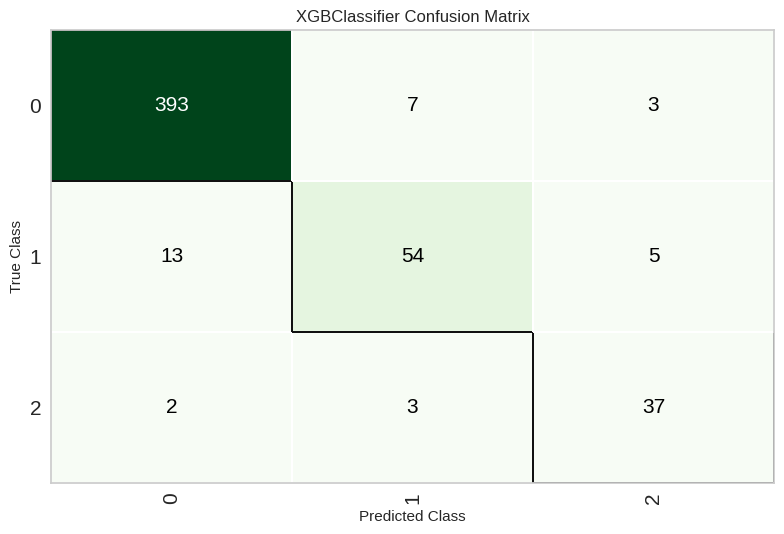

In [21]:
# Seeing the confusion matrix
plot_model(tuned_xgb, plot='confusion_matrix')

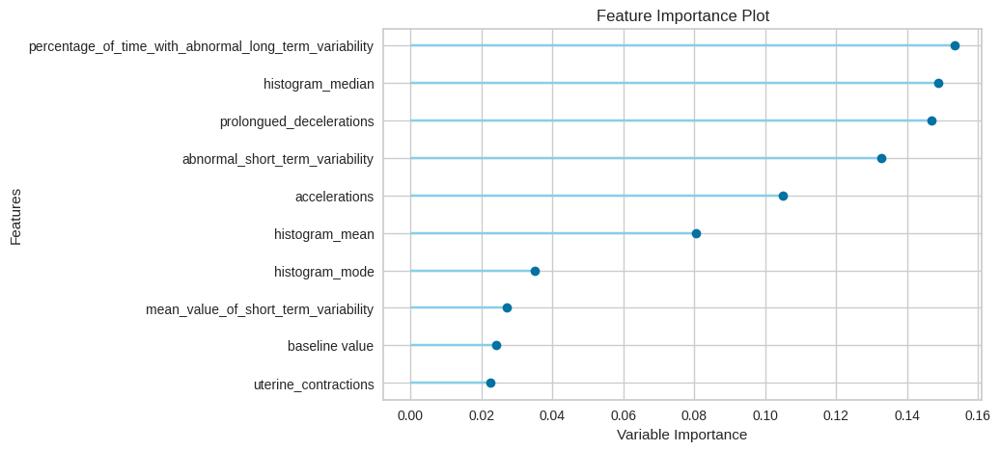

In [22]:
# Features
plot_model(tuned_xgb, plot='feature')

* Abore are the most important columns.
---
And now I'll finalize the model and do the predicts.

In [23]:
# Predicting the model test data
predict_model(tuned_xgb)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Extreme Gradient Boosting,0.9362,0.9866,0.9362,0.9351,0.9352,0.8230,0.8235


,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health,prediction_label,prediction_score
646,146.0,0.000,0.000,0.004,0.004,0.0,0.0,28.0,1.4,15.0,...,4.0,0.0,148.0,145.0,151.0,24.0,1.0,0,1,0.9918
1332,114.0,0.000,0.000,0.009,0.000,0.0,0.0,65.0,0.5,0.0,...,1.0,0.0,115.0,115.0,116.0,1.0,0.0,0,1,0.9951
1707,136.0,0.000,0.001,0.008,0.001,0.0,0.0,67.0,1.9,0.0,...,2.0,0.0,135.0,132.0,136.0,2.0,1.0,0,1,0.9998
564,130.0,0.000,0.000,0.007,0.000,0.0,0.0,55.0,0.5,11.0,...,1.0,0.0,133.0,132.0,134.0,0.0,0.0,0,1,0.9977
631,146.0,0.000,0.000,0.003,0.000,0.0,0.0,65.0,0.4,39.0,...,1.0,0.0,150.0,149.0,151.0,1.0,1.0,1,2,0.9997
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1119,145.0,0.000,0.000,0.003,0.000,0.0,0.0,51.0,0.7,7.0,...,1.0,0.0,153.0,152.0,153.0,1.0,0.0,1,2,0.9053
100,158.0,0.000,0.000,0.000,0.000,0.0,0.0,57.0,0.5,58.0,...,0.0,0.0,165.0,165.0,166.0,0.0,0.0,0,2,0.7239
1199,132.0,0.010,0.000,0.010,0.000,0.0,0.0,27.0,1.7,0.0,...,8.0,0.0,150.0,146.0,149.0,18.0,1.0,0,1,0.9998
1459,143.0,0.000,0.000,0.001,0.000,0.0,0.0,69.0,0.3,6.0,...,1.0,0.0,145.0,144.0,146.0,1.0,0.0,0,1,0.9074


In [24]:
# Finalizing the model
f_model = finalize_model(tuned_xgb)

* Now I'll use the datasets split at the beggining.

In [28]:
# Test data
test_pred = predict_model(f_model, data=test)

# Facilitate the visualize
test_pred['prediction_label'] = test_pred['prediction_label'].replace(1,'0')
test_pred['prediction_label'] = test_pred['prediction_label'].replace(2,'1')
test_pred['prediction_label'] = test_pred['prediction_label'].replace(3,'2')

# Check
test_pred[['fetal_health','prediction_label','prediction_score']]

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Extreme Gradient Boosting,0.9577,0.9909,0.9577,0.9572,0.9574,0.8858,0.8859


,fetal_health,prediction_label,prediction_score
0,0,0,0.9345
1,0,0,1.0000
2,0,0,0.9999
3,1,1,0.9990
4,0,0,0.9999
5,0,0,0.9999
6,1,1,0.9967
7,0,0,0.9995
8,2,2,0.9990
9,2,2,0.9985


In [30]:
# val data
val_pred = predict_model(f_model, data=val)


# Facilitate the visualize
val_pred['prediction_label'] = val_pred['prediction_label'].replace(1,'0')
val_pred['prediction_label'] = val_pred['prediction_label'].replace(2,'1')
val_pred['prediction_label'] = val_pred['prediction_label'].replace(3,'2')

# Check
val_pred[['fetal_health','prediction_label','prediction_score']]

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Extreme Gradient Boosting,0.9581,0.9941,0.9581,0.9600,0.9546,0.8804,0.8866


,fetal_health,prediction_label,prediction_score
0,0,0,1.0000
1,0,0,0.9998
2,0,0,0.9951
3,0,0,0.9838
4,2,2,0.9336
5,0,0,0.9023
6,0,0,0.8155
7,0,0,0.9966
8,0,0,0.9990
9,1,2,0.8096


# **Final words:**
The model achieve a good score on both datasets, train and val, above 90 percent. In the end, now we have a good model that can auxiliary the doctors.
* And if you like or this project helped you, leave a comment in this post and follow me in social networks bellow.
 * **`Instagram:`** https://www.instagram.com/pit.nlima/
 * **`LinkedIn:`** https://www.linkedin.com/in/piternicolas/